In [1]:
#B

# **Loading Dataset**

In [2]:
#import required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import warnings
warnings.filterwarnings('ignore')

#models

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier


In [3]:
#load Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
warnings.filterwarnings('ignore')

# Visualization settings
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")
%matplotlib inline

# Set display options
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)

print("=" * 80)
print("LA CRIME DATA ANALYSIS - ARREST OUTCOME PREDICTION")
print("=" * 80)

LA CRIME DATA ANALYSIS - ARREST OUTCOME PREDICTION


In [5]:
# At the start of notebook
!nvidia-smi  # Check GPU info

# For scikit-learn models (they don't use GPU by default)
# Use n_jobs=-1 to use all CPU cores instead
RandomForestClassifier(n_jobs=-1)  # Already in your code

Wed Feb 18 15:49:13 2026       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 580.82.07              Driver Version: 580.82.07      CUDA Version: 13.0     |
+-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   39C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

RandomForestClassifier(n_jobs=-1)

In [6]:
# Check GPU availability
import torch
print("GPU Available:", torch.cuda.is_available())
if torch.cuda.is_available():
    print("GPU Name:", torch.cuda.get_device_name(0))
    print("GPU Memory:", torch.cuda.get_device_properties(0).total_memory / 1e9, "GB")

GPU Available: True
GPU Name: Tesla T4
GPU Memory: 15.637086208 GB


In [7]:
dataset_path = '/content/drive/MyDrive/QM-640-Capstone/dataset/'
dataset_file = 'Crime_Data_from_2020_to_Present.csv'

dataset_file_path = dataset_path + dataset_file

#load the dataset into Pandas
df = pd.read_csv(dataset_file_path)


In [8]:
#Check the shape
df.shape

(1004991, 28)

In [9]:
#Check the head and tail
df.head()

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
0,211507896,04/11/2021 12:00:00 AM,11/07/2020 12:00:00 AM,845,15,N Hollywood,1502,2,354,THEFT OF IDENTITY,0377,31,M,H,501.0,SINGLE FAMILY DWELLING,NaN,NaN,IC,Invest Cont,354.0,NaN,NaN,NaN,7800 BEEMAN AV,NaN,34.2124,-118.4092
1,201516622,10/21/2020 12:00:00 AM,10/18/2020 12:00:00 AM,1845,15,N Hollywood,1521,1,230,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",0416 0334 2004 1822 1414 0305 0319 0400,32,M,H,102.0,SIDEWALK,200.0,KNIFE WITH BLADE 6INCHES OR LESS,IC,Invest Cont,230.0,NaN,NaN,NaN,ATOLL AV,N GAULT,34.1993,-118.4203
2,240913563,12/10/2024 12:00:00 AM,10/30/2020 12:00:00 AM,1240,9,Van Nuys,933,2,354,THEFT OF IDENTITY,0377,30,M,W,501.0,SINGLE FAMILY DWELLING,NaN,NaN,IC,Invest Cont,354.0,NaN,NaN,NaN,14600 SYLVAN ST,NaN,34.1847,-118.4509
3,210704711,12/24/2020 12:00:00 AM,12/24/2020 12:00:00 AM,1310,7,Wilshire,782,1,331,THEFT FROM MOTOR VEHICLE - GRAND ($950.01 AND ...,0344,47,F,A,101.0,STREET,NaN,NaN,IC,Invest Cont,331.0,NaN,NaN,NaN,6000 COMEY AV,NaN,34.0339,-118.3747
4,201418201,10/03/2020 12:00:00 AM,09/29/2020 12:00:00 AM,1830,14,Pacific,1454,1,420,THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER),1300 0344 1606 2032,63,M,H,103.0,ALLEY,NaN,NaN,IC,Invest Cont,420.0,NaN,NaN,NaN,4700 LA VILLA MARINA,NaN,33.9813,-118.4350


In [10]:
#check the tail
df.tail()

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
1004986,252104112,02/02/2025 12:00:00 AM,02/02/2025 12:00:00 AM,130,21,Topanga,2103,2,946,OTHER MISCELLANEOUS CRIME,NaN,35,M,X,101.0,STREET,NaN,NaN,IC,Invest Cont,946.0,NaN,NaN,NaN,22100 ROSCOE BL,NaN,34.2259,-118.6126
1004987,250404100,02/18/2025 12:00:00 AM,02/18/2025 12:00:00 AM,1000,4,Hollenbeck,479,2,237,CHILD NEGLECT (SEE 300 W.I.C.),1258 0553 0602,11,M,B,501.0,SINGLE FAMILY DWELLING,NaN,NaN,IC,Invest Cont,237.0,NaN,NaN,NaN,3500 PERCY ST,NaN,34.0277,-118.1979
1004988,251304095,01/31/2025 12:00:00 AM,01/30/2025 12:00:00 AM,1554,13,Newton,1372,2,850,INDECENT EXPOSURE,NaN,16,F,H,101.0,STREET,NaN,NaN,IC,Invest Cont,850.0,NaN,NaN,NaN,300 E 53RD ST,NaN,33.9942,-118.2701
1004989,251704066,01/17/2025 12:00:00 AM,01/17/2025 12:00:00 AM,1600,17,Devonshire,1774,2,624,BATTERY - SIMPLE ASSAULT,0400 1259 1822 0356,17,M,H,721.0,HIGH SCHOOL,400.0,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",IC,Invest Cont,624.0,NaN,NaN,NaN,9600 ZELZAH AV,NaN,34.2450,-118.5233
1004990,251904210,03/25/2025 12:00:00 AM,03/25/2025 12:00:00 AM,1235,19,Mission,1944,2,850,INDECENT EXPOSURE,0529 2024 1815 0913,35,F,H,721.0,HIGH SCHOOL,NaN,NaN,IC,Invest Cont,850.0,NaN,NaN,NaN,11100 OMELVENY AV,NaN,34.2722,-118.4417


In [11]:
#check the data types
df.dtypes

,0
DR_NO,int64
Date Rptd,object
DATE OCC,object
TIME OCC,int64
AREA,int64
AREA NAME,object
Rpt Dist No,int64
Part 1-2,int64
Crm Cd,int64
Crm Cd Desc,object


In [12]:
df.columns = df.columns.str.lower().str.replace(' ', '_')

# Display the standardized column names
print("Standardized Column Names:")
print("=" * 60)
for i, col in enumerate(df.columns, 1):
    print(f"{i:2d}. {col}")

print("\n" + "=" * 60)
print(f"Total columns: {len(df.columns)}")
print("Standardization complete!")
print("=" * 60)

# Optional: Display first few rows with new column names
print("\nFirst 3 rows with standardized columns:")
print(df.head(3))

Standardized Column Names:
 1. dr_no
 2. date_rptd
 3. date_occ
 4. time_occ
 5. area
 6. area_name
 7. rpt_dist_no
 8. part_1-2
 9. crm_cd
10. crm_cd_desc
11. mocodes
12. vict_age
13. vict_sex
14. vict_descent
15. premis_cd
16. premis_desc
17. weapon_used_cd
18. weapon_desc
19. status
20. status_desc
21. crm_cd_1
22. crm_cd_2
23. crm_cd_3
24. crm_cd_4
25. location
26. cross_street
27. lat
28. lon

Total columns: 28
Standardization complete!

First 3 rows with standardized columns:
       dr_no               date_rptd                date_occ  time_occ  area  \
0  211507896  04/11/2021 12:00:00 AM  11/07/2020 12:00:00 AM       845    15   
1  201516622  10/21/2020 12:00:00 AM  10/18/2020 12:00:00 AM      1845    15   
2  240913563  12/10/2024 12:00:00 AM  10/30/2020 12:00:00 AM      1240     9   

     area_name  rpt_dist_no  part_1-2  crm_cd  \
0  N Hollywood         1502         2     354   
1  N Hollywood         1521         1     230   
2     Van Nuys          933         2     354

In [13]:
#data cleaning


# **Data Cleaning**

In [14]:
print("\n" + "=" * 80)
print("DATA CLEANING")
print("=" * 80)


DATA CLEANING


In [15]:
# Store original shape
original_shape = df.shape
print(f"\n[2/10] Starting data cleaning...")
print(f"Original dataset: {original_shape}")


[2/10] Starting data cleaning...
Original dataset: (1004991, 28)


In [16]:
# 2.1: Remove duplicates based on DR_NO (unique identifier)
print("\n--- Removing Duplicates ---")
print(f"Duplicates found: {df.duplicated(subset='dr_no').sum()}")
df = df.drop_duplicates(subset='dr_no', keep='first')
print(f"After removing duplicates: {df.shape}")


--- Removing Duplicates ---
Duplicates found: 0
After removing duplicates: (1004991, 28)


In [17]:
# 2.2: Convert data types
print("\n--- Converting Data Types ---")
# Date and time conversions
df['date_occ'] = pd.to_datetime(df['date_occ'], errors='coerce')
df['date_rptd'] = pd.to_datetime(df['date_rptd'], errors='coerce')



--- Converting Data Types ---


In [18]:
# Convert time (stored as integer like 2130) to proper format
df['time_occ'] = pd.to_numeric(df['time_occ'], errors='coerce')

# Numeric columns
numeric_cols = ['vict_age', 'lat', 'lon', 'crm_cd']
for col in numeric_cols:
    if col in df.columns:
        df[col] = pd.to_numeric(df[col], errors='coerce')

In [19]:
# 2.3: Handle invalid victim ages
print("\n--- Cleaning Victim Age ---")
print(f"Age statistics before cleaning:\n{df['vict_age'].describe()}")
print(f"Ages = 0: {(df['vict_age'] == 0).sum()}")
print(f"Negative ages: {(df['vict_age'] < 0).sum()}")
print(f"Ages > 120: {(df['vict_age'] > 120).sum()}")


--- Cleaning Victim Age ---
Age statistics before cleaning:
count    1.004991e+06
mean     2.891706e+01
std      2.199272e+01
min     -4.000000e+00
25%      0.000000e+00
50%      3.000000e+01
75%      4.400000e+01
max      1.200000e+02
Name: vict_age, dtype: float64
Ages = 0: 269222
Negative ages: 137
Ages > 120: 0


In [20]:
# Replace invalid ages with NaN
df.loc[(df['vict_age'] <= 0) | (df['vict_age'] > 120), 'vict_age'] = np.nan
print(f"After cleaning - Ages with NaN: {df['vict_age'].isna().sum()}")


After cleaning - Ages with NaN: 269359


In [21]:
# 2.4: Handle invalid coordinates
print("\n--- Cleaning Geographic Coordinates ---")
print(f"Records with (0, 0) coordinates: {((df['lat'] == 0) & (df['lon'] == 0)).sum()}")
df.loc[(df['lat'] == 0) | (df['lon'] == 0), ['lat', 'lon']] = np.nan



--- Cleaning Geographic Coordinates ---
Records with (0, 0) coordinates: 2240


In [22]:
# 2.5: Create target variable (Arrest Status)
print("\n--- Creating Target Variable: Arrest Status ---")
# The 'status' column typically contains arrest information
# Status codes: AA (Adult Arrest), JA (Juvenile Arrest), IC (Investigation Continued)
df['arrest_made'] = df['status'].apply(
    lambda x: 1 if str(x).strip() in ['AA', 'JA', 'Adult Arrest', 'Juv Arrest'] else 0
)
print(f"Arrest distribution:\n{df['arrest_made'].value_counts()}")
print(f"Arrest rate: {df['arrest_made'].mean():.2%}")



--- Creating Target Variable: Arrest Status ---
Arrest distribution:
arrest_made
0    914550
1     90441
Name: count, dtype: int64
Arrest rate: 9.00%


In [23]:
# 2.6: Missing value summary
print("\n--- Missing Values Summary ---")
missing_summary = pd.DataFrame({
    'Column': df.columns,
    'Missing_Count': df.isnull().sum(),
    'Missing_Percentage': (df.isnull().sum() / len(df) * 100).round(2)
}).sort_values('Missing_Percentage', ascending=False)
print(missing_summary[missing_summary['Missing_Count'] > 0].head(15))


--- Missing Values Summary ---
                        Column  Missing_Count  Missing_Percentage
crm_cd_4              crm_cd_4        1004927               99.99
crm_cd_3              crm_cd_3        1002677               99.77
crm_cd_2              crm_cd_2         935831               93.12
cross_street      cross_street         850755               84.65
weapon_used_cd  weapon_used_cd         677744               67.44
weapon_desc        weapon_desc         677744               67.44
vict_age              vict_age         269359               26.80
mocodes                mocodes         151619               15.09
vict_descent      vict_descent         144656               14.39
vict_sex              vict_sex         144644               14.39
lon                        lon           2240                0.22
lat                        lat           2240                0.22
premis_desc        premis_desc            588                0.06
status                  status              

In [24]:
# 2.7: Drop columns with >70% missing values
cols_to_drop = missing_summary[missing_summary['Missing_Percentage'] > 70]['Column'].tolist()
print(f"\nDropping {len(cols_to_drop)} columns with >70% missing values")
df = df.drop(columns=cols_to_drop, errors='ignore')


Dropping 4 columns with >70% missing values


In [25]:
# 2.8: Remove rows where target variable is missing
df = df.dropna(subset=['arrest_made'])

print(f"\n--- Data Cleaning Complete ---")
print(f"Final dataset: {df.shape}")
print(f"Rows removed: {original_shape[0] - df.shape[0]} ({((original_shape[0] - df.shape[0])/original_shape[0]*100):.2f}%)")



--- Data Cleaning Complete ---
Final dataset: (1004991, 25)
Rows removed: 0 (0.00%)


# **EXPLORATORY DATA ANALYSIS (EDA)**

In [26]:
print("\n" + "=" * 80)
print("EXPLORATORY DATA ANALYSIS")
print("=" * 80)

print("\n[3/10] Performing EDA...")

# Create figure directory
import os
os.makedirs('figures', exist_ok=True)


EXPLORATORY DATA ANALYSIS

[3/10] Performing EDA...


In [27]:
#3.1: Temporal Analysis
print("\n--- Temporal Analysis ---")

# Extract temporal features
df['year'] = df['date_occ'].dt.year
df['month'] = df['date_occ'].dt.month
df['day_of_week'] = df['date_occ'].dt.dayofweek
df['hour'] = (df['time_occ'] // 100).astype('Int64')


--- Temporal Analysis ---


Text(0.5, 0.98, 'Temporal Analysis of Crime and Arrests')

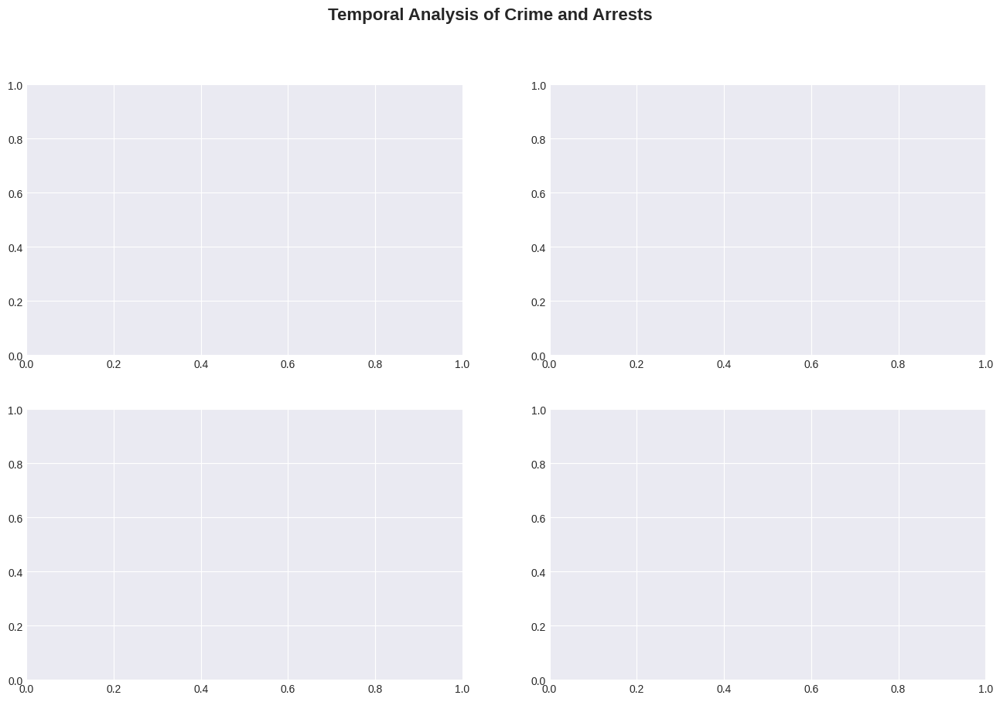

In [28]:
# Arrest trends over time
fig, axes = plt.subplots(2, 2, figsize=(16, 10))
fig.suptitle('Temporal Analysis of Crime and Arrests', fontsize=16, fontweight='bold')

In [29]:
# Plot 1: Crimes and arrests by year
yearly_stats = df.groupby('year').agg({
    'dr_no': 'count',
    'arrest_made': ['sum', 'mean']
}).reset_index()
yearly_stats.columns = ['Year', 'Total_Crimes', 'Total_Arrests', 'Arrest_Rate']

ax1 = axes[0, 0]
ax1_twin = ax1.twinx()
ax1.bar(yearly_stats['Year'], yearly_stats['Total_Crimes'], alpha=0.7, color='steelblue', label='Total Crimes')
ax1_twin.plot(yearly_stats['Year'], yearly_stats['Arrest_Rate']*100, color='red', marker='o', linewidth=2, label='Arrest Rate %')
ax1.set_xlabel('Year', fontweight='bold')
ax1.set_ylabel('Total Crimes', fontweight='bold', color='steelblue')
ax1_twin.set_ylabel('Arrest Rate (%)', fontweight='bold', color='red')
ax1.set_title('Crime Volume vs Arrest Rate by Year')
ax1.legend(loc='upper left')
ax1_twin.legend(loc='upper right')
ax1.grid(True, alpha=0.3)


In [30]:
# Plot 2: Monthly pattern
monthly_stats = df.groupby('month').agg({
    'arrest_made': ['sum', 'mean']
}).reset_index()
monthly_stats.columns = ['Month', 'Total_Arrests', 'Arrest_Rate']
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

ax2 = axes[0, 1]
ax2.plot(range(1, 13), monthly_stats['Arrest_Rate']*100, marker='o', linewidth=2, markersize=8, color='crimson')
ax2.set_xlabel('Month', fontweight='bold')
ax2.set_ylabel('Arrest Rate (%)', fontweight='bold')
ax2.set_title('Arrest Rate by Month - Seasonal Pattern')
ax2.set_xticks(range(1, 13))
ax2.set_xticklabels(month_names, rotation=45)
ax2.grid(True, alpha=0.3)
max_month = monthly_stats.loc[monthly_stats['Arrest_Rate'].idxmax(), 'Month']
ax2.axvline(max_month, color='green', linestyle='--', alpha=0.5)
ax2.text(max_month, ax2.get_ylim()[1]*0.95, f'Peak: {month_names[int(max_month)-1]}',
         ha='center', fontweight='bold', color='green')


Text(4, 9.367827452141636, 'Peak: Apr')

In [31]:
# Plot 3: Day of week pattern
dow_names = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']
dow_stats = df.groupby('day_of_week')['arrest_made'].mean().reset_index()

ax3 = axes[1, 0]
bars = ax3.bar(range(7), dow_stats['arrest_made']*100, color=sns.color_palette("RdYlGn", 7))
ax3.set_xlabel('Day of Week', fontweight='bold')
ax3.set_ylabel('Arrest Rate (%)', fontweight='bold')
ax3.set_title('Arrest Rate by Day of Week')
ax3.set_xticks(range(7))
ax3.set_xticklabels(dow_names)
ax3.grid(True, alpha=0.3, axis='y')
# Plot 4: Hourly pattern
hourly_stats = df.groupby('hour')['arrest_made'].mean().reset_index()

ax4 = axes[1, 1]
ax4.fill_between(hourly_stats['hour'], hourly_stats['arrest_made']*100, alpha=0.6, color='orange')
ax4.plot(hourly_stats['hour'], hourly_stats['arrest_made']*100, linewidth=2, color='darkorange')
ax4.set_xlabel('Hour of Day', fontweight='bold')
ax4.set_ylabel('Arrest Rate (%)', fontweight='bold')
ax4.set_title('Arrest Rate by Hour of Day')
ax4.set_xticks(range(0, 24, 2))
ax4.grid(True, alpha=0.3)
peak_hour = hourly_stats.loc[hourly_stats['arrest_made'].idxmax(), 'hour']
ax4.axvline(peak_hour, color='red', linestyle='--', alpha=0.7)
ax4.text(peak_hour, ax4.get_ylim()[1]*0.95, f'Peak: {int(peak_hour)}:00',
         ha='center', fontweight='bold', color='red')
ax1.grid(True, alpha=0.3, axis='x')
ax2.grid(True, alpha=0.3, axis='x')
ax3.grid(True, alpha=0.3, axis='x')
ax4.grid(True, alpha=0.3, axis='x')


plt.tight_layout()
plt.savefig('figures/temporal_analysis.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n INSIGHT: Temporal patterns reveal when arrests are most likely:")
print(f"   - Peak arrest month: {month_names[int(max_month)-1]}")
print(f"   - Peak arrest hour: {int(peak_hour)}:00")
print(f"   - Weekend vs Weekday arrest rate difference observed")




<Figure size 640x480 with 0 Axes>


 INSIGHT: Temporal patterns reveal when arrests are most likely:
   - Peak arrest month: Apr
   - Peak arrest hour: 11:00
   - Weekend vs Weekday arrest rate difference observed



--- Crime Type Analysis ---


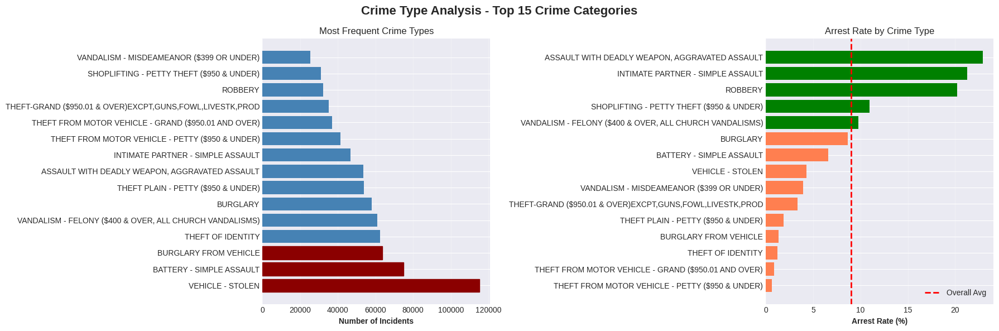


 INSIGHT: Crime types show vastly different arrest rates:
   - Highest arrest rate: ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT (22.9%)
   - Lowest arrest rate: THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER) (0.6%)
   - Most frequent: VEHICLE - STOLEN (115,190 incidents)


In [32]:
# 3.2: Crime Type Analysis
print("\n--- Crime Type Analysis ---")

# Top crime types
crime_type_stats = df.groupby('crm_cd_desc').agg({
    'dr_no': 'count',
    'arrest_made': ['sum', 'mean']
}).reset_index()
crime_type_stats.columns = ['Crime_Type', 'Total_Count', 'Arrests', 'Arrest_Rate']
crime_type_stats = crime_type_stats.sort_values('Total_Count', ascending=False).head(15)

fig, axes = plt.subplots(1, 2, figsize=(18, 6))
fig.suptitle('Crime Type Analysis - Top 15 Crime Categories', fontsize=16, fontweight='bold')

# Plot 1: Crime frequency
ax1 = axes[0]
bars = ax1.barh(crime_type_stats['Crime_Type'], crime_type_stats['Total_Count'], color='steelblue')
ax1.set_xlabel('Number of Incidents', fontweight='bold')
ax1.set_title('Most Frequent Crime Types')
ax1.grid(True, alpha=0.3, axis='x')

# Highlight top 3
for i in range(3):
    bars[i].set_color('darkred')

# Plot 2: Arrest rates by crime type
ax2 = axes[1]
crime_sorted = crime_type_stats.sort_values('Arrest_Rate', ascending=True)
colors = ['green' if x > df['arrest_made'].mean() else 'coral' for x in crime_sorted['Arrest_Rate']]
ax2.barh(crime_sorted['Crime_Type'], crime_sorted['Arrest_Rate']*100, color=colors)
ax2.axvline(df['arrest_made'].mean()*100, color='red', linestyle='--', linewidth=2, label='Overall Avg')
ax2.set_xlabel('Arrest Rate (%)', fontweight='bold')
ax2.set_title('Arrest Rate by Crime Type')
ax2.legend()
ax2.grid(True, alpha=0.3, axis='x')

plt.tight_layout()
plt.savefig('figures/crime_type_analysis.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n INSIGHT: Crime types show vastly different arrest rates:")
top_arrest_crime = crime_type_stats.sort_values('Arrest_Rate', ascending=False).iloc[0]
low_arrest_crime = crime_type_stats.sort_values('Arrest_Rate', ascending=True).iloc[0]
print(f"   - Highest arrest rate: {top_arrest_crime['Crime_Type']} ({top_arrest_crime['Arrest_Rate']*100:.1f}%)")
print(f"   - Lowest arrest rate: {low_arrest_crime['Crime_Type']} ({low_arrest_crime['Arrest_Rate']*100:.1f}%)")
print(f"   - Most frequent: {crime_type_stats.iloc[0]['Crime_Type']} ({crime_type_stats.iloc[0]['Total_Count']:,} incidents)")


High-frequency crimes such as vehicle theft and simple battery do not necessarily correspond to high arrest rates. Violent offenses tend to have higher arrest probabilities, highlighting enforcement effectiveness differences across crime categories.


--- Geographic Analysis ---


Text(0.5, 0.98, 'Geographic Analysis - Top 15 LAPD Areas')

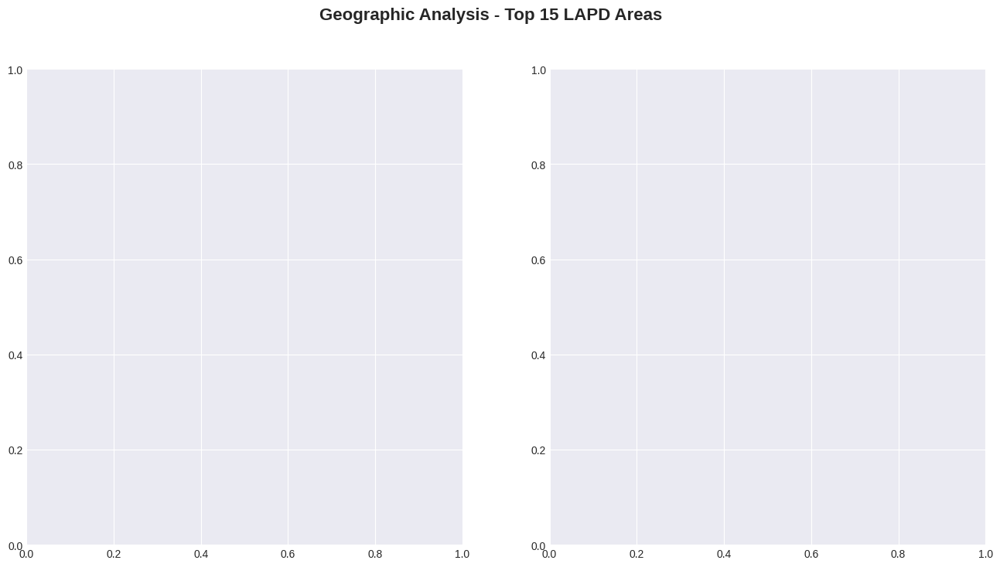

In [33]:
# 3.3: Geographic Analysis
print("\n--- Geographic Analysis ---")

# Area analysis
area_stats = df.groupby('area_name').agg({
    'dr_no': 'count',
    'arrest_made': ['sum', 'mean']
}).reset_index()
area_stats.columns = ['Area', 'Total_Crimes', 'Arrests', 'Arrest_Rate']
area_stats = area_stats.sort_values('Total_Crimes', ascending=False).head(15)

fig, axes = plt.subplots(1, 2, figsize=(16, 8))
fig.suptitle('Geographic Analysis - Top 15 LAPD Areas', fontsize=16, fontweight='bold')


In [34]:
# Crime volume by area
ax1 = axes[0]
ax1.barh(area_stats['Area'], area_stats['Total_Crimes'], color='teal')
ax1.set_xlabel('Number of Crimes', fontweight='bold')
ax1.set_title('Crime Volume by LAPD Area')
ax1.grid(True, alpha=0.3, axis='x')

# Arrest rate by area
ax2 = axes[1]
area_sorted = area_stats.sort_values('Arrest_Rate', ascending=True)
colors = ['darkgreen' if x > df['arrest_made'].mean() else 'indianred' for x in area_sorted['Arrest_Rate']]
ax2.barh(area_sorted['Area'], area_sorted['Arrest_Rate']*100, color=colors)
ax2.axvline(df['arrest_made'].mean()*100, color='blue', linestyle='--', linewidth=2, label='City Average')
ax2.set_xlabel('Arrest Rate (%)', fontweight='bold')
ax2.set_title('Arrest Rate by LAPD Area')
ax2.legend()
ax2.grid(True, alpha=0.3, axis='x')

plt.tight_layout()
plt.savefig('figures/geographic_analysis.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n INSIGHT: Geographic disparities in crime and arrests:")
high_crime_area = area_stats.iloc[0]
print(f"   - Highest crime area: {high_crime_area['Area']} ({high_crime_area['Total_Crimes']:,} crimes)")
print(f"   - Arrest rates vary from {area_sorted['Arrest_Rate'].min()*100:.1f}% to {area_sorted['Arrest_Rate'].max()*100:.1f}%")



<Figure size 640x480 with 0 Axes>


 INSIGHT: Geographic disparities in crime and arrests:
   - Highest crime area: Central (69,670 crimes)
   - Arrest rates vary from 6.1% to 12.5%



--- Victim Demographics Analysis ---


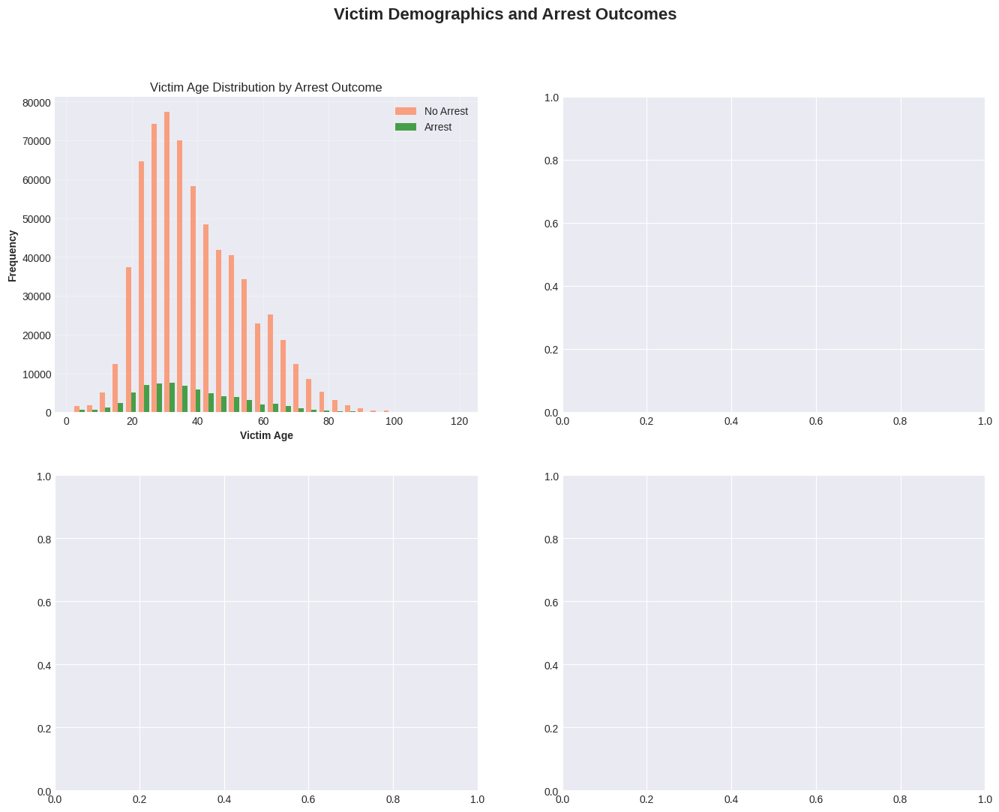

In [35]:
# 3.4: Victim Demographics
print("\n--- Victim Demographics Analysis ---")

fig, axes = plt.subplots(2, 2, figsize=(16, 12))
fig.suptitle('Victim Demographics and Arrest Outcomes', fontsize=16, fontweight='bold')

# Age distribution
ax1 = axes[0, 0]
age_arrests = df.dropna(subset=['vict_age'])
arrest_yes = age_arrests[age_arrests['arrest_made'] == 1]['vict_age']
arrest_no = age_arrests[age_arrests['arrest_made'] == 0]['vict_age']

ax1.hist([arrest_no, arrest_yes], bins=30, label=['No Arrest', 'Arrest'], alpha=0.7, color=['coral', 'green'])
ax1.set_xlabel('Victim Age', fontweight='bold')
ax1.set_ylabel('Frequency', fontweight='bold')
ax1.set_title('Victim Age Distribution by Arrest Outcome')
ax1.legend()
ax1.grid(True, alpha=0.3)


In [36]:
# Sex analysis
ax2 = axes[0, 1]
sex_stats = df[df['vict_sex'].isin(['M', 'F'])].groupby('vict_sex')['arrest_made'].agg(['count', 'mean']).reset_index()
sex_stats.columns = ['Sex', 'Count', 'Arrest_Rate']
sex_labels = {'M': 'Male', 'F': 'Female'}
sex_stats['Sex_Label'] = sex_stats['Sex'].map(sex_labels)

x_pos = np.arange(len(sex_stats))
bars = ax2.bar(x_pos, sex_stats['Arrest_Rate']*100, color=['steelblue', 'pink'])
ax2.set_ylabel('Arrest Rate (%)', fontweight='bold')
ax2.set_title('Arrest Rate by Victim Sex')
ax2.set_xticks(x_pos)
ax2.set_xticklabels(sex_stats['Sex_Label'])
ax2.grid(True, alpha=0.3, axis='y')

# Add value labels
for i, (bar, val) in enumerate(zip(bars, sex_stats['Arrest_Rate']*100)):
    ax2.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.5,
             f'{val:.1f}%', ha='center', va='bottom', fontweight='bold')


In [37]:
# Descent analysis
ax3 = axes[1, 0]
descent_stats = df.groupby('vict_descent')['arrest_made'].agg(['count', 'mean']).reset_index()
descent_stats.columns = ['Descent', 'Count', 'Arrest_Rate']
descent_stats = descent_stats[descent_stats['Count'] >= 1000].sort_values('Count', ascending=False).head(10)

ax3.barh(descent_stats['Descent'], descent_stats['Arrest_Rate']*100, color='mediumpurple')
ax3.set_xlabel('Arrest Rate (%)', fontweight='bold')
ax3.set_title('Arrest Rate by Victim Descent (Top 10)')
ax3.grid(True, alpha=0.3, axis='x')


In [38]:
# Weapon analysis
ax4 = axes[1, 1]
weapon_stats = df.groupby('weapon_desc')['arrest_made'].agg(['count', 'mean']).reset_index()
weapon_stats.columns = ['Weapon', 'Count', 'Arrest_Rate']
weapon_stats = weapon_stats[weapon_stats['Count'] >= 1000].sort_values('Arrest_Rate', ascending=False).head(10)

colors_weapon = plt.cm.RdYlGn(weapon_stats['Arrest_Rate'] / weapon_stats['Arrest_Rate'].max())
ax4.barh(weapon_stats['Weapon'], weapon_stats['Arrest_Rate']*100, color=colors_weapon)
ax4.set_xlabel('Arrest Rate (%)', fontweight='bold')
ax4.set_title('Arrest Rate by Weapon Type (Top 10)')
ax4.grid(True, alpha=0.3, axis='x')

plt.tight_layout()
plt.savefig('figures/victim_demographics.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n INSIGHT: Demographic factors influence arrest likelihood:")
print(f"   - Male victim arrest rate: {sex_stats[sex_stats['Sex']=='M']['Arrest_Rate'].values[0]*100:.1f}%")
print(f"   - Female victim arrest rate: {sex_stats[sex_stats['Sex']=='F']['Arrest_Rate'].values[0]*100:.1f}%")
print(f"   - Weapon involvement significantly impacts arrest rates")



<Figure size 640x480 with 0 Axes>


 INSIGHT: Demographic factors influence arrest likelihood:
   - Male victim arrest rate: 9.3%
   - Female victim arrest rate: 10.1%
   - Weapon involvement significantly impacts arrest rates



--- Feature Correlation Analysis ---


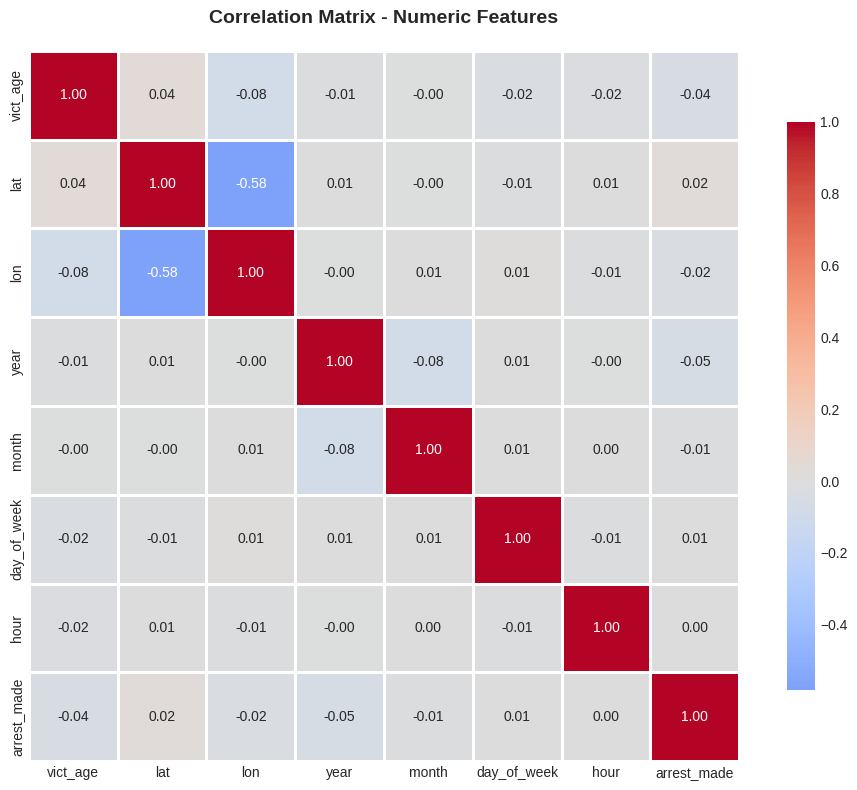


 Feature correlations with arrest outcome:
lat            0.024802
day_of_week    0.005294
hour           0.002112
month         -0.012884
lon           -0.023852
vict_age      -0.043498
year          -0.046806
Name: arrest_made, dtype: float64


In [39]:
# 3.5: Correlation Analysis
print("\n--- Feature Correlation Analysis ---")

# Create correlation matrix for numeric features
numeric_features = ['vict_age', 'lat', 'lon', 'year', 'month', 'day_of_week', 'hour', 'arrest_made']
corr_df = df[numeric_features].dropna()
corr_matrix = corr_df.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', center=0,
            square=True, linewidths=1, cbar_kws={"shrink": 0.8})
plt.title('Correlation Matrix - Numeric Features', fontsize=14, fontweight='bold', pad=20)
plt.tight_layout()
plt.savefig('figures/correlation_matrix.png', dpi=300, bbox_inches='tight')
plt.show()

# Show top correlations with arrest outcome
arrest_corr = corr_matrix['arrest_made'].sort_values(ascending=False)
print("\n Feature correlations with arrest outcome:")
print(arrest_corr[arrest_corr.index != 'arrest_made'])



Most numeric variables show weak correlations, suggesting crime occurrence is influenced by complex, non-linear interactions rather than simple linear relationships. A moderate negative correlation between latitude and longitude reflects geographic structuring.



In [39]:
#NEW EDA

**NEW EDA**

In [40]:
# Ensure datetime
df['date_occ'] = pd.to_datetime(df['date_occ'], errors='coerce')

# Extract temporal features
df['year'] = df['date_occ'].dt.year
df['month'] = df['date_occ'].dt.month
df['hour'] = df['time_occ'] // 100  # convert 1300 → 13

# Create arrest flag
df['arrest_made'] = df['status_desc'].str.contains('Arrest', case=False, na=False)

Temporal Analysis – Crimes vs Arrest Rate by Year

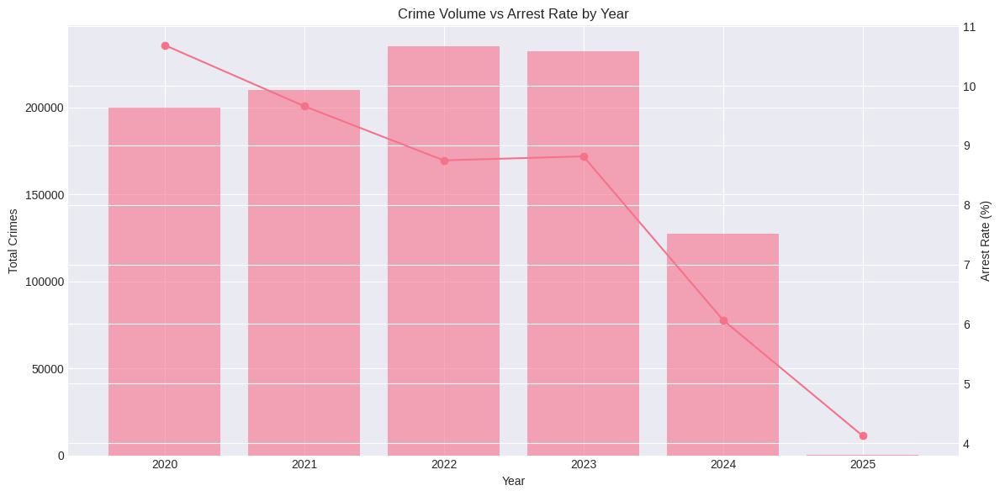

In [41]:
yearly_stats = df.groupby('year').agg(
    total_crimes=('dr_no', 'count'),
    total_arrests=('arrest_made', 'sum')
).reset_index()

yearly_stats['arrest_rate'] = yearly_stats['total_arrests'] / yearly_stats['total_crimes']

fig, ax1 = plt.subplots(figsize=(12,6))

ax2 = ax1.twinx()

ax1.bar(yearly_stats['year'], yearly_stats['total_crimes'], alpha=0.6)
ax2.plot(yearly_stats['year'], yearly_stats['arrest_rate']*100, marker='o')

ax1.set_xlabel("Year")
ax1.set_ylabel("Total Crimes")
ax2.set_ylabel("Arrest Rate (%)")

plt.title("Crime Volume vs Arrest Rate by Year")
plt.tight_layout()
plt.show()


Total crime volume increased steadily from 2020 to 2023, followed by a noticeable decline in 2024 and 2025 (likely partial-year data). However, the arrest rate shows a gradual downward trend over time, suggesting that while crime volume fluctuated, the proportion of cases resulting in arrests declined. This may indicate increasing case complexity, resource constraints, or reporting changes.

Monthly Crime Trend

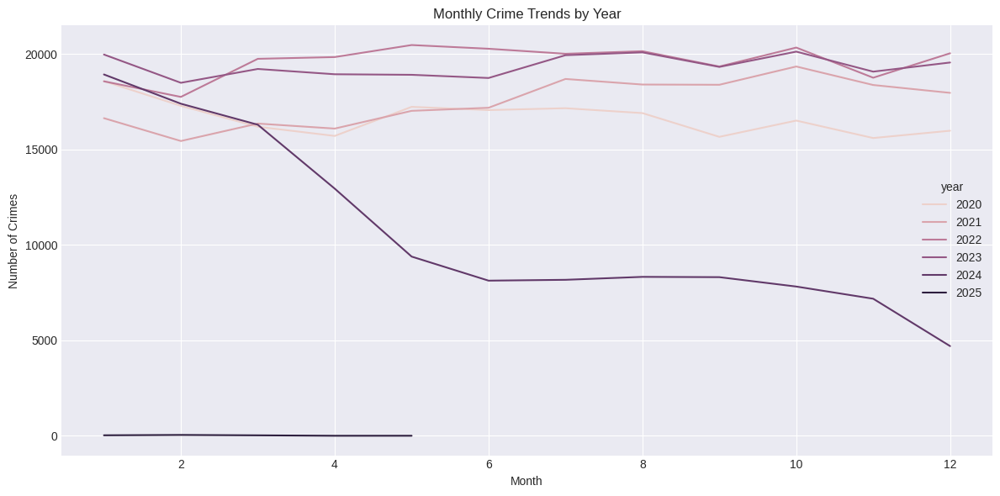

In [42]:
monthly_stats = df.groupby(['year','month']).size().reset_index(name='crime_count')

plt.figure(figsize=(12,6))
sns.lineplot(data=monthly_stats, x='month', y='crime_count', hue='year')
plt.title("Monthly Crime Trends by Year")
plt.xlabel("Month")
plt.ylabel("Number of Crimes")
plt.tight_layout()
plt.show()


Crime levels exhibit consistent seasonal patterns, with moderate fluctuations across months each year. Typically, crime appears slightly higher during mid-year and early fall months compared to early spring. The sharp drop observed in 2025 likely reflects incomplete yearly data rather than an actual decline.

Crime by Hour of Day

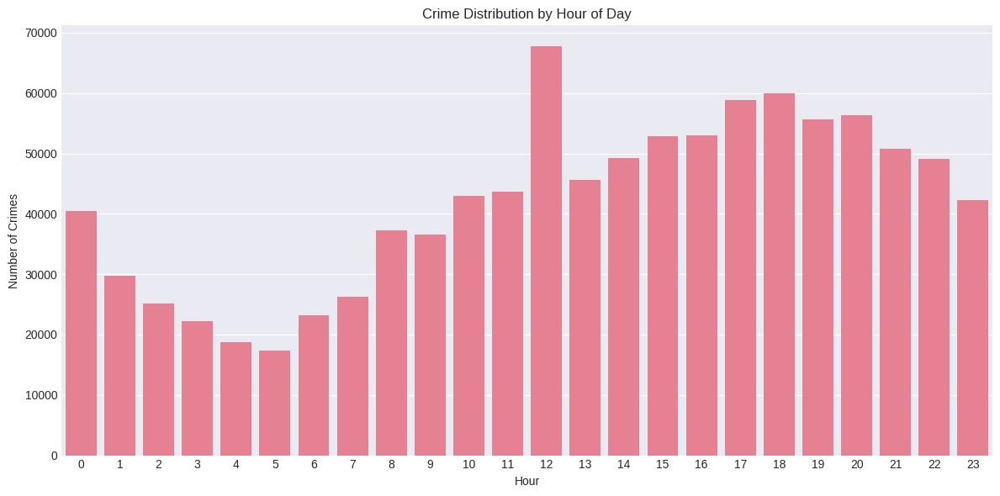

In [43]:
hourly_stats = df.groupby('hour').size().reset_index(name='crime_count')

plt.figure(figsize=(12,6))
sns.barplot(data=hourly_stats, x='hour', y='crime_count')
plt.title("Crime Distribution by Hour of Day")
plt.xlabel("Hour")
plt.ylabel("Number of Crimes")
plt.tight_layout()
plt.show()


Crime activity is lowest during early morning hours (around 3–6 AM) and gradually increases throughout the day. The highest concentration of crimes occurs in the late afternoon and evening (approximately 12 PM to 8 PM), indicating that crime incidents peak during high public activity hours. This pattern aligns with routine activity theory, where increased human interaction raises opportunity for offenses.


Arrest Rate by Hour (Very Insightful)

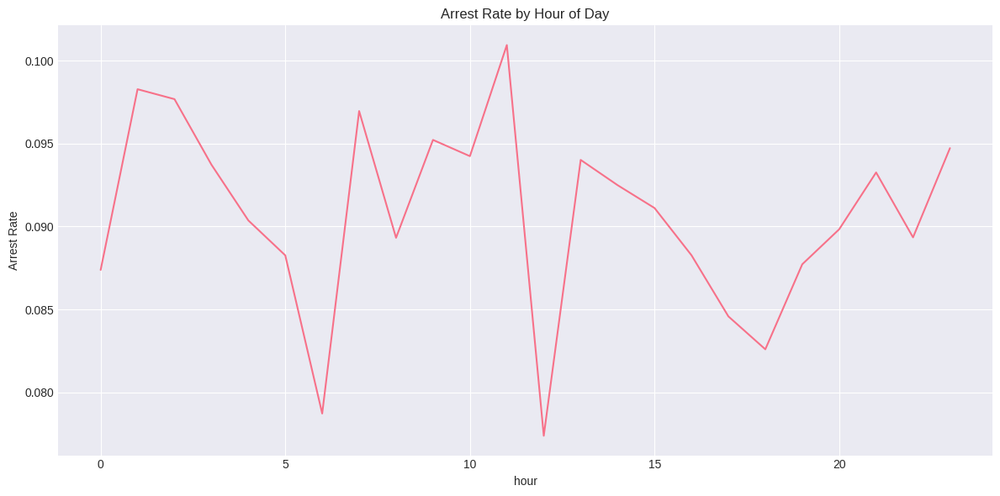

In [44]:
hourly_arrest = df.groupby('hour').agg(
    total_crimes=('dr_no','count'),
    total_arrests=('arrest_made','sum')
).reset_index()

hourly_arrest['arrest_rate'] = hourly_arrest['total_arrests'] / hourly_arrest['total_crimes']

plt.figure(figsize=(12,6))
sns.lineplot(data=hourly_arrest, x='hour', y='arrest_rate')
plt.title("Arrest Rate by Hour of Day")
plt.ylabel("Arrest Rate")
plt.tight_layout()
plt.show()


Arrest rates remain relatively stable throughout the day, with minor fluctuations across hours. There is no strong correlation between peak crime hours and significantly higher arrest success, suggesting enforcement effectiveness remains fairly consistent across time periods. Slight dips during certain hours may reflect operational or situational factors rather than systemic inefficiency.

Yearly Crime Trend by Top 10 Crime Types

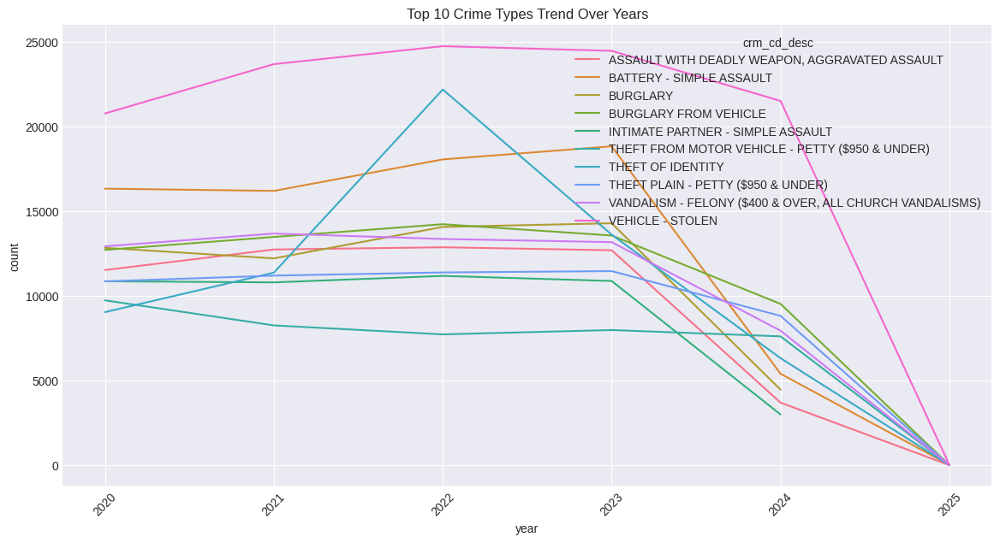

In [45]:

top_crimes = df['crm_cd_desc'].value_counts().head(10).index

crime_trend = df[df['crm_cd_desc'].isin(top_crimes)] \
    .groupby(['year','crm_cd_desc']).size().reset_index(name='count')

plt.figure(figsize=(14,7))
sns.lineplot(data=crime_trend, x='year', y='count', hue='crm_cd_desc')
plt.title("Top 10 Crime Types Trend Over Years")
plt.xticks(rotation=45)
plt.show()


Most major crime categories increased from 2020 to 2022, followed by stabilization or decline in 2023–2024. Property crimes such as vehicle theft and identity theft show notable volatility compared to assault-related crimes.

Area-Wise Crime Evolution

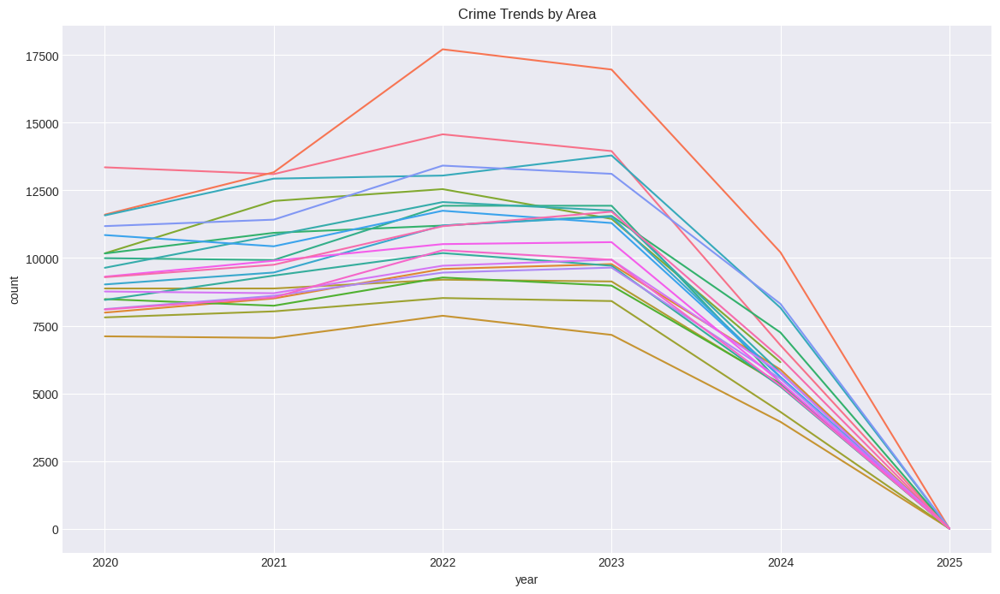

In [46]:
area_trend = df.groupby(['year','area_name']).size().reset_index(name='count')

plt.figure(figsize=(14,8))
sns.lineplot(data=area_trend, x='year', y='count', hue='area_name', legend=False)
plt.title("Crime Trends by Area")
plt.show()


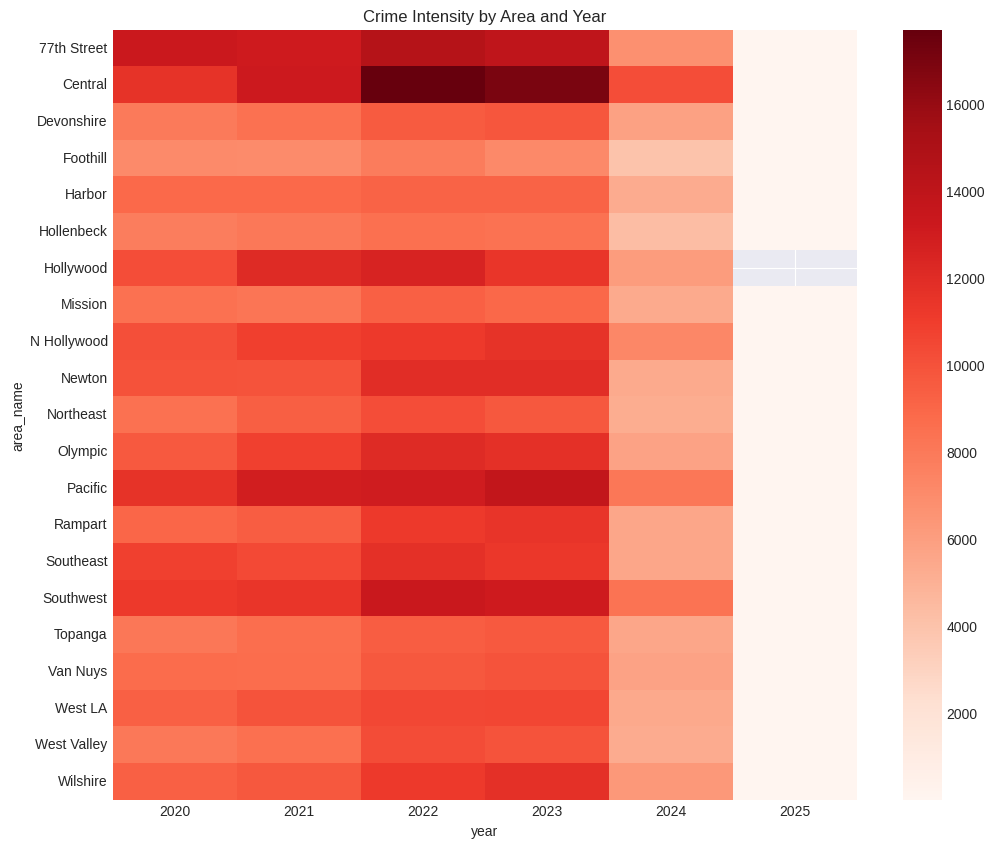

In [47]:
pivot_area = df.pivot_table(index='area_name',
                            columns='year',
                            values='dr_no',
                            aggfunc='count')

plt.figure(figsize=(12,10))
sns.heatmap(pivot_area, cmap='Reds')
plt.title("Crime Intensity by Area and Year")
plt.show()


Crime concentration is consistently higher in areas such as Central, Pacific, and Southwest, indicating spatial clustering. Most divisions show peak intensity around 2022–2023 with a visible decline in 2024.

Geographic Heatmap of Crime Intensity

In [48]:
import folium
from folium.plugins import HeatMap

m = folium.Map(location=[df['lat'].mean(), df['lon'].mean()], zoom_start=10)

heat_data = df[['lat','lon']].dropna().values.tolist()

HeatMap(heat_data, radius=8).add_to(m)

m


Predictive Trend Modeling (Simple Forecast)

In [49]:
from statsmodels.tsa.arima.model import ARIMA

yearly_total = df.groupby('year').size()

model = ARIMA(yearly_total, order=(1,1,1))
model_fit = model.fit()

forecast = model_fit.forecast(steps=3)

print("Forecasted Crimes Next 3 Years:")
print(forecast)


/usr/local/lib/python3.12/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.
  self._init_dates(dates, freq)
/usr/local/lib/python3.12/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.
  self._init_dates(dates, freq)
/usr/local/lib/python3.12/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.
  self._init_dates(dates, freq)


Forecasted Crimes Next 3 Years:
6    96.840552
7    96.840551
8    96.840551
Name: predicted_mean, dtype: float64


/usr/local/lib/python3.12/dist-packages/statsmodels/tsa/base/tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


Arrest Probability by Crime Type

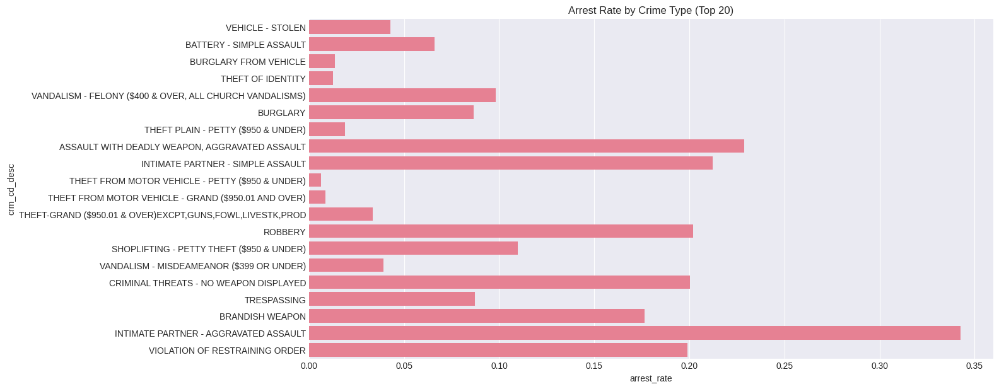

In [50]:
arrest_by_crime = df.groupby('crm_cd_desc').agg(
    total=('dr_no','count'),
    arrests=('arrest_made','sum')
).reset_index()

arrest_by_crime['arrest_rate'] = arrest_by_crime['arrests'] / arrest_by_crime['total']

top20 = arrest_by_crime.sort_values('total', ascending=False).head(20)

plt.figure(figsize=(14,7))
sns.barplot(data=top20, x='arrest_rate', y='crm_cd_desc')
plt.title("Arrest Rate by Crime Type (Top 20)")
plt.show()


Violent crimes (e.g., aggravated assault, intimate partner assault) exhibit significantly higher arrest rates than property crimes. Theft-related offenses show comparatively low arrest probabilities, indicating enforcement or solvability differences.

Victim Demographics Analysis

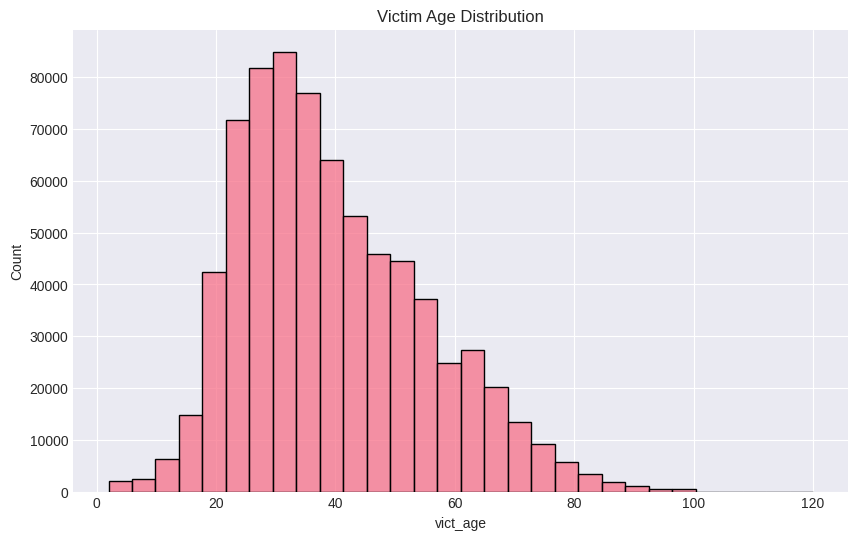

In [51]:
plt.figure(figsize=(10,6))
sns.histplot(df['vict_age'], bins=30)
plt.title("Victim Age Distribution")
plt.show()


Crime victimization is most concentrated among individuals aged roughly 20–40, with a gradual decline in older age groups. This suggests higher exposure or activity-related risk among young adults.

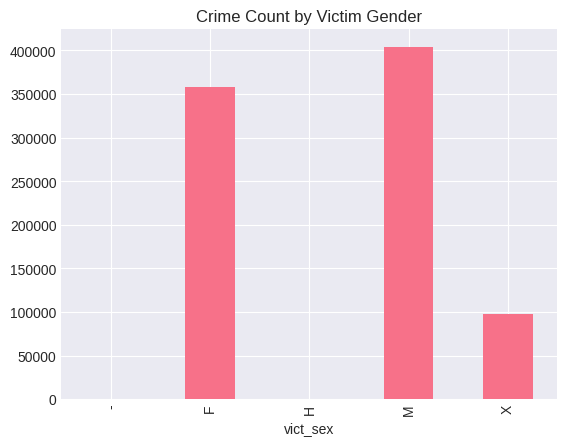

In [52]:
gender_crime = df.groupby('vict_sex').size()

gender_crime.plot(kind='bar')
plt.title("Crime Count by Victim Gender")
plt.show()


Male victims slightly outnumber female victims, though both genders experience substantial crime incidence. A smaller but non-negligible proportion is recorded under unspecified/other categories.

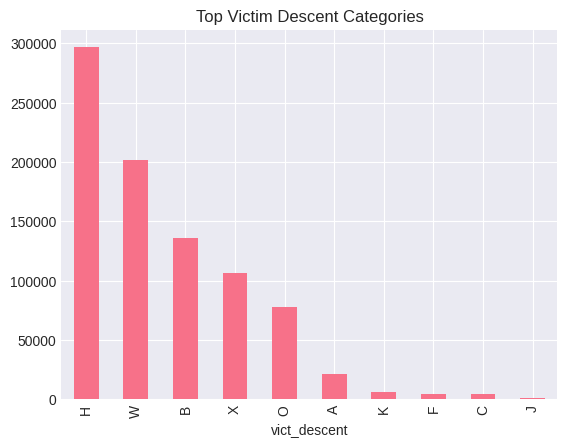

In [53]:
descent_crime = df.groupby('vict_descent').size().sort_values(ascending=False)

descent_crime.head(10).plot(kind='bar')
plt.title("Top Victim Descent Categories")
plt.show()


Certain descent categories (e.g., H and W) account for a disproportionately higher number of victims, reflecting demographic distribution and/or differential exposure across communities.

Crime vs Police Area Density

In [54]:
area_density = df.groupby('area_name').agg(
    crimes=('dr_no','count'),
    arrests=('arrest_made','sum')
)

area_density['arrest_rate'] = area_density['arrests'] / area_density['crimes']

area_density.sort_values('crimes', ascending=False).head(10)


,crimes,arrests,arrest_rate
area_name,,,
Central,69670,4239,0.060844
77th Street,61758,5577,0.090304
Pacific,59514,3992,0.067077
Southwest,57441,4986,0.086802
Hollywood,52429,4160,0.079345
N Hollywood,51107,6363,0.124503
Olympic,50071,3957,0.079028
Southeast,49936,3406,0.068207
Newton,49177,3797,0.077211


In [55]:
from sklearn.cluster import KMeans
import numpy as np

coords = df[['lat','lon']].dropna()

kmeans = KMeans(n_clusters=5, random_state=42)
df.loc[coords.index, 'cluster'] = kmeans.fit_predict(coords)


# **FEATURE ENGINEERING**

In [40]:
print("\n" + "=" * 80)
print("FEATURE ENGINEERING")
print("=" * 80)

print("\n[4/10] Engineering features for modeling...")

# Create a copy for modeling
df_model = df.copy()

# 4.1: Time-based features
print("\n--- Creating temporal features ---")
df_model['is_weekend'] = df_model['day_of_week'].isin([5, 6]).astype(int)
df_model['is_night'] = df_model['hour'].apply(lambda x: 1 if (x >= 20 or x <= 6) else 0 if pd.notna(x) else np.nan)
df_model['season'] = df_model['month'].apply(
    lambda x: 'Winter' if x in [12, 1, 2] else
              'Spring' if x in [3, 4, 5] else
              'Summer' if x in [6, 7, 8] else 'Fall' if pd.notna(x) else np.nan
)


FEATURE ENGINEERING

[4/10] Engineering features for modeling...

--- Creating temporal features ---


In [41]:
# 4.2: Categorical encoding
print("--- Encoding categorical features ---")

# Select relevant categorical features
categorical_features = ['area_name', 'crm_cd_desc', 'vict_sex', 'vict_descent',
                        'premis_desc', 'weapon_desc', 'season']

# Fill missing values for categorical features
for col in categorical_features:
    if col in df_model.columns:
        df_model[col] = df_model[col].fillna('Unknown')

# For high cardinality features, keep top categories
def reduce_cardinality(df, column, top_n=20):
    top_categories = df[column].value_counts().head(top_n).index
    df[column] = df[column].apply(lambda x: x if x in top_categories else 'Other')
    return df

df_model = reduce_cardinality(df_model, 'crm_cd_desc', 25)
df_model = reduce_cardinality(df_model, 'premis_desc', 20)
df_model = reduce_cardinality(df_model, 'weapon_desc', 15)



--- Encoding categorical features ---


In [42]:
# 4.3: Select features for modeling
print("\n--- Selecting features for modeling ---")

# Numeric features
numeric_features_model = ['vict_age', 'hour', 'month', 'day_of_week', 'is_weekend', 'is_night']

# Categorical features to encode
categorical_features_model = ['area_name', 'crm_cd_desc', 'vict_sex', 'vict_descent',
                               'premis_desc', 'weapon_desc', 'season']

# All features
all_features = numeric_features_model + categorical_features_model

# Create feature dataframe
X = df_model[all_features].copy()
y = df_model['arrest_made'].copy()

# Fill missing numeric values with median
for col in numeric_features_model:
    if col in X.columns:
        X[col] = X[col].fillna(X[col].median())

print(f"\nFeatures selected: {len(all_features)}")
print(f"Numeric features: {len(numeric_features_model)}")
print(f"Categorical features: {len(categorical_features_model)}")
print(f"\nTarget variable distribution:")
print(y.value_counts())
print(f"Class imbalance ratio: {y.value_counts()[0]/y.value_counts()[1]:.2f}:1")



--- Selecting features for modeling ---

Features selected: 13
Numeric features: 6
Categorical features: 7

Target variable distribution:
arrest_made
0    914550
1     90441
Name: count, dtype: int64
Class imbalance ratio: 10.11:1


# **DATA PREPROCESSING FOR MODELING**

In [43]:
print("\n" + "=" * 80)
print("DATA PREPROCESSING")
print("=" * 80)

print("\n[5/10] Preprocessing data for modeling...")

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE

# 5.1: Encode categorical variables
print("\n--- Encoding categorical variables ---")
label_encoders = {}
X_encoded = X.copy()

for col in categorical_features_model:
    if col in X_encoded.columns:
        le = LabelEncoder()
        X_encoded[col] = le.fit_transform(X_encoded[col].astype(str))
        label_encoders[col] = le

print(f"Encoded {len(label_encoders)} categorical features")

# 5.2: Train-test split (70-30 split)
print("\n--- Splitting data ---")
X_train, X_test, y_train, y_test = train_test_split(
    X_encoded, y, test_size=0.30, random_state=42, stratify=y
)

print(f"Training set: {X_train.shape[0]} samples")
print(f"Test set: {X_test.shape[0]} samples")
print(f"Train arrest rate: {y_train.mean()*100:.2f}%")
print(f"Test arrest rate: {y_test.mean()*100:.2f}%")

# 5.3: Feature scaling
print("\n--- Scaling features ---")
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 5.4: Handle class imbalance with SMOTE
print("\n--- Handling class imbalance with SMOTE ---")
print(f"Before SMOTE - Class distribution:")
print(f"  Class 0 (No Arrest): {(y_train==0).sum()}")
print(f"  Class 1 (Arrest): {(y_train==1).sum()}")

smote = SMOTE(random_state=42, k_neighbors=5)
X_train_balanced, y_train_balanced = smote.fit_resample(X_train_scaled, y_train)

print(f"\nAfter SMOTE - Class distribution:")
print(f"  Class 0 (No Arrest): {(y_train_balanced==0).sum()}")
print(f"  Class 1 (Arrest): {(y_train_balanced==1).sum()}")



DATA PREPROCESSING

[5/10] Preprocessing data for modeling...

--- Encoding categorical variables ---
Encoded 7 categorical features

--- Splitting data ---
Training set: 703493 samples
Test set: 301498 samples
Train arrest rate: 9.00%
Test arrest rate: 9.00%

--- Scaling features ---

--- Handling class imbalance with SMOTE ---
Before SMOTE - Class distribution:
  Class 0 (No Arrest): 640184
  Class 1 (Arrest): 63309

After SMOTE - Class distribution:
  Class 0 (No Arrest): 640184
  Class 1 (Arrest): 640184


# **MODEL TRAINING**

In [44]:
print("\n" + "=" * 80)
print("MODEL TRAINING - COMPARATIVE STUDY")
print("=" * 80)

print("\n[6/10] Training multiple classifiers...")


# Define models with justification
models = {
    'Logistic Regression': {
        'model': LogisticRegression(max_iter=1000, random_state=42),
        'justification': 'Baseline linear model; interpretable coefficients for feature importance; fast training'
    },
    'Decision Tree': {
        'model': DecisionTreeClassifier(max_depth=10, random_state=42),
        'justification': 'Non-linear relationships; handles categorical features well; interpretable rules; visualizable decision paths'
    },
    'Random Forest': {
        'model': RandomForestClassifier(n_estimators=100, max_depth=15, random_state=42, n_jobs=-1),
        'justification': 'Ensemble method; reduces overfitting; handles imbalanced data; provides feature importance; robust to outliers'
    },
    'Artificial Neural Network': {
        'model': MLPClassifier(hidden_layer_sizes=(100, 50), max_iter=500, random_state=42, early_stopping=True, validation_fraction=0.1),
        'justification': 'Deep learning approach; captures complex non-linear patterns; learns hierarchical features; scalable to large datasets'
    }
}

print("\n MODEL JUSTIFICATIONS:")
print("=" * 80)
for i, (name, info) in enumerate(models.items(), 1):
    print(f"{i}. {name}")
    print(f"   Justification: {info['justification']}\n")

# Train models
trained_models = {}
training_times = {}

print("\n Training models...")
print("=" * 80)

import time

for name, info in models.items():
    print(f"\nTraining {name}...", end=' ')
    start_time = time.time()

    model = info['model']
    model.fit(X_train_balanced, y_train_balanced)

    training_time = time.time() - start_time
    trained_models[name] = model
    training_times[name] = training_time

    print(f"Completed in {training_time:.2f}s")

print("\n All models trained successfully!")



MODEL TRAINING - COMPARATIVE STUDY

[6/10] Training multiple classifiers...

 MODEL JUSTIFICATIONS:
1. Logistic Regression
   Justification: Baseline linear model; interpretable coefficients for feature importance; fast training

2. Decision Tree
   Justification: Non-linear relationships; handles categorical features well; interpretable rules; visualizable decision paths

3. Random Forest
   Justification: Ensemble method; reduces overfitting; handles imbalanced data; provides feature importance; robust to outliers

4. Artificial Neural Network
   Justification: Deep learning approach; captures complex non-linear patterns; learns hierarchical features; scalable to large datasets


 Training models...

Training Logistic Regression... Completed in 2.29s

Training Decision Tree... Completed in 9.26s

Training Random Forest... Completed in 207.99s

Training Artificial Neural Network... Completed in 1109.80s

 All models trained successfully!


# **MODEL EVALUATION**

In [45]:
print("\n" + "=" * 80)
print("MODEL EVALUATION & PERFORMANCE METRICS")
print("=" * 80)

print("\n[7/10] Evaluating model performance...")

from sklearn.metrics import (accuracy_score, precision_score, recall_score,
                             f1_score, roc_auc_score, confusion_matrix,
                             classification_report, roc_curve)

# Store results
results = []

print("\n Generating predictions and metrics...")

for name, model in trained_models.items():
    # Predictions
    y_pred = model.predict(X_test_scaled)
    y_pred_proba = model.predict_proba(X_test_scaled)[:, 1] if hasattr(model, 'predict_proba') else None

    # Metrics
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, zero_division=0)
    recall = recall_score(y_test, y_pred, zero_division=0)
    f1 = f1_score(y_test, y_pred, zero_division=0)

    # ROC-AUC
    if y_pred_proba is not None:
        roc_auc = roc_auc_score(y_test, y_pred_proba)
    else:
        roc_auc = np.nan

    results.append({
        'Model': name,
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1-Score': f1,
        'ROC-AUC': roc_auc,
        'Training Time (s)': training_times[name]
    })

# Create results dataframe
results_df = pd.DataFrame(results)
results_df = results_df.sort_values('F1-Score', ascending=False)

print("\n" + "=" * 80)
print("COMPARATIVE MODEL PERFORMANCE")
print("=" * 80)
print(results_df.to_string(index=False))

# Save results
results_df.to_csv('model_performance_results.csv', index=False)
print("\n Results saved to 'model_performance_results.csv'")



MODEL EVALUATION & PERFORMANCE METRICS

[7/10] Evaluating model performance...

 Generating predictions and metrics...

COMPARATIVE MODEL PERFORMANCE
                    Model  Accuracy  Precision   Recall  F1-Score  ROC-AUC  Training Time (s)
            Random Forest  0.831180   0.249425 0.435980  0.317314 0.770823         207.989383
Artificial Neural Network  0.793810   0.212223 0.476117  0.293584 0.738639        1109.803701
            Decision Tree  0.768304   0.198498 0.518355  0.287067 0.742048           9.255235
      Logistic Regression  0.711491   0.163638 0.536599  0.250795 0.652128           2.293398

 Results saved to 'model_performance_results.csv'


# **DETAILED PERFORMANCE VISUALIZATION**


[8/10] Creating performance visualizations...


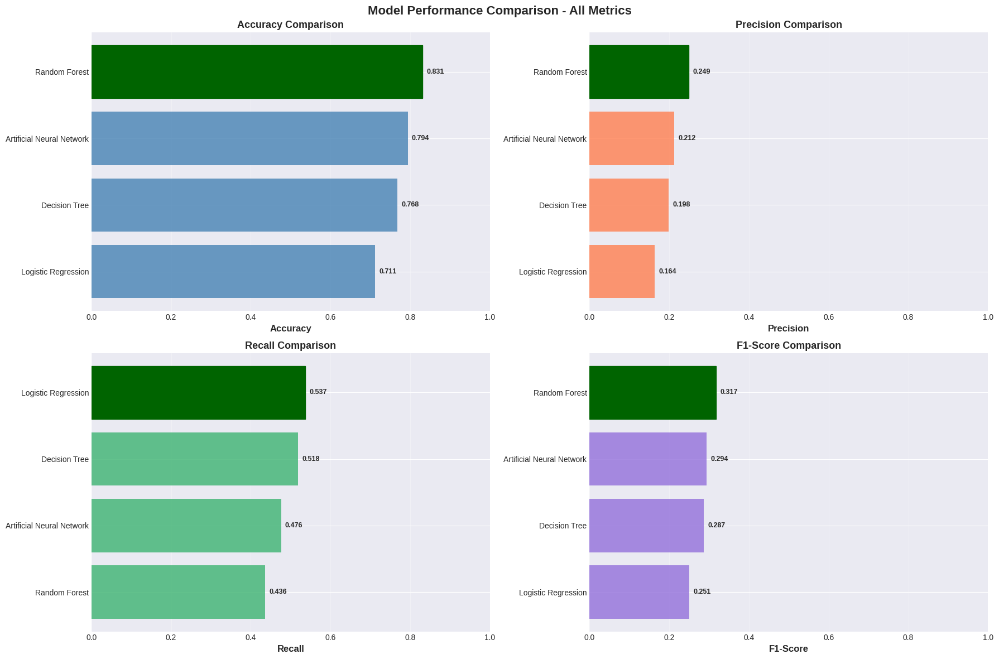


--- Plotting ROC Curves ---


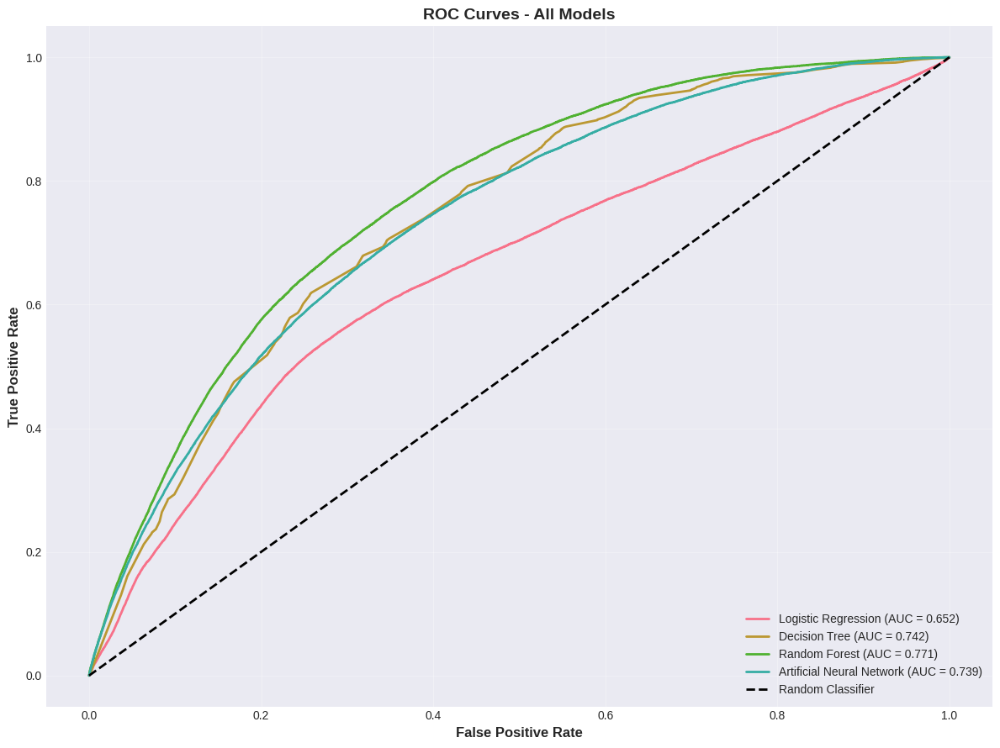


--- Confusion Matrices for Top 3 Models ---


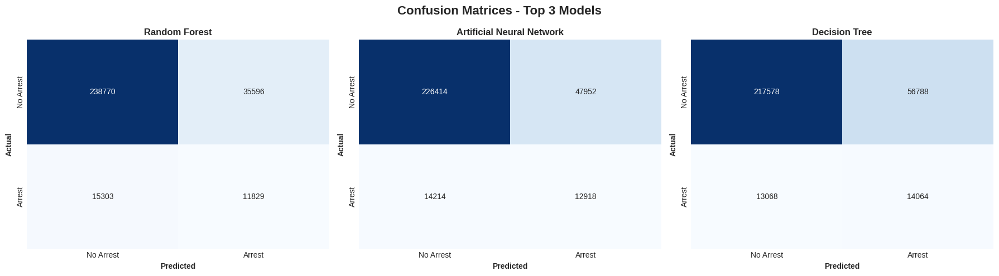


--- Feature Importance Analysis ---


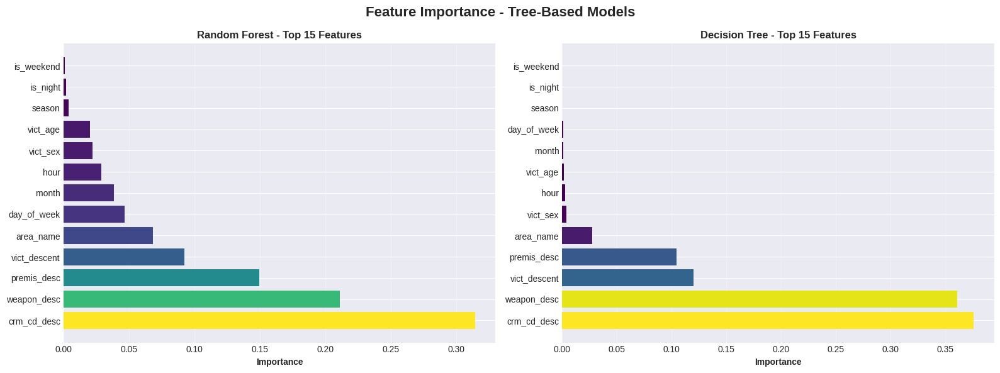

In [46]:
print("\n[8/10] Creating performance visualizations...")

# 8.1: Performance comparison bar charts
fig, axes = plt.subplots(2, 2, figsize=(18, 12))
fig.suptitle('Model Performance Comparison - All Metrics', fontsize=16, fontweight='bold')

metrics = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
colors_list = ['steelblue', 'coral', 'mediumseagreen', 'mediumpurple']

for idx, (metric, color) in enumerate(zip(metrics, colors_list)):
    ax = axes[idx // 2, idx % 2]
    data_sorted = results_df.sort_values(metric, ascending=True)

    bars = ax.barh(data_sorted['Model'], data_sorted[metric], color=color, alpha=0.8)

    # Highlight best model
    best_idx = data_sorted[metric].argmax()
    bars[best_idx].set_color('darkgreen')
    bars[best_idx].set_alpha(1.0)

    ax.set_xlabel(metric, fontweight='bold', fontsize=12)
    ax.set_title(f'{metric} Comparison', fontweight='bold', fontsize=13)
    ax.set_xlim(0, 1)
    ax.grid(True, alpha=0.3, axis='x')

    # Add value labels
    for i, (bar, val) in enumerate(zip(bars, data_sorted[metric])):
        ax.text(val + 0.01, bar.get_y() + bar.get_height()/2,
                f'{val:.3f}', va='center', fontweight='bold', fontsize=9)

plt.tight_layout()
plt.savefig('figures/model_comparison_metrics.png', dpi=300, bbox_inches='tight')
plt.show()

# 8.2: ROC Curves
print("\n--- Plotting ROC Curves ---")

plt.figure(figsize=(12, 9))

for name, model in trained_models.items():
    if hasattr(model, 'predict_proba'):
        y_pred_proba = model.predict_proba(X_test_scaled)[:, 1]
        fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
        auc_score = roc_auc_score(y_test, y_pred_proba)
        plt.plot(fpr, tpr, linewidth=2, label=f'{name} (AUC = {auc_score:.3f})')

plt.plot([0, 1], [0, 1], 'k--', linewidth=2, label='Random Classifier')
plt.xlabel('False Positive Rate', fontweight='bold', fontsize=12)
plt.ylabel('True Positive Rate', fontweight='bold', fontsize=12)
plt.title('ROC Curves - All Models', fontweight='bold', fontsize=14)
plt.legend(loc='lower right', fontsize=10)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.savefig('figures/roc_curves.png', dpi=300, bbox_inches='tight')
plt.show()

# 8.3: Confusion Matrices for Top 3 Models
print("\n--- Confusion Matrices for Top 3 Models ---")

top_3_models = results_df.head(3)['Model'].tolist()

fig, axes = plt.subplots(1, 3, figsize=(18, 5))
fig.suptitle('Confusion Matrices - Top 3 Models', fontsize=16, fontweight='bold')

for idx, model_name in enumerate(top_3_models):
    model = trained_models[model_name]
    y_pred = model.predict(X_test_scaled)
    cm = confusion_matrix(y_test, y_pred)

    ax = axes[idx]
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax, cbar=False,
                xticklabels=['No Arrest', 'Arrest'],
                yticklabels=['No Arrest', 'Arrest'])
    ax.set_title(model_name, fontweight='bold', fontsize=12)
    ax.set_ylabel('Actual', fontweight='bold')
    ax.set_xlabel('Predicted', fontweight='bold')

plt.tight_layout()
plt.savefig('figures/confusion_matrices_top3.png', dpi=300, bbox_inches='tight')
plt.show()

# 8.4: Feature Importance (for tree-based models)
print("\n--- Feature Importance Analysis ---")

# Only tree-based models have feature_importances_
tree_based_models = ['Random Forest', 'Decision Tree']
available_tree_models = [m for m in tree_based_models if m in trained_models]

if available_tree_models:
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    fig.suptitle('Feature Importance - Tree-Based Models', fontsize=16, fontweight='bold')

    for idx, model_name in enumerate(available_tree_models):
        model = trained_models[model_name]

        if hasattr(model, 'feature_importances_'):
            importances = model.feature_importances_
            feature_names = all_features

            # Create dataframe
            feat_imp_df = pd.DataFrame({
                'Feature': feature_names,
                'Importance': importances
            }).sort_values('Importance', ascending=False).head(15)

            ax = axes[idx]
            bars = ax.barh(feat_imp_df['Feature'], feat_imp_df['Importance'],
                          color=plt.cm.viridis(feat_imp_df['Importance'] / feat_imp_df['Importance'].max()))
            ax.set_xlabel('Importance', fontweight='bold')
            ax.set_title(f'{model_name} - Top 15 Features', fontweight='bold')
            ax.grid(True, alpha=0.3, axis='x')

    plt.tight_layout()
    plt.savefig('figures/feature_importance.png', dpi=300, bbox_inches='tight')
    plt.show()


# **DETAILED CLASSIFICATION REPORTS**

In [47]:
print("\n" + "=" * 80)
print("DETAILED CLASSIFICATION REPORTS")
print("=" * 80)

print("\n[9/10] Generating detailed classification reports...")

for name in top_3_models:
    model = trained_models[name]
    y_pred = model.predict(X_test_scaled)

    print(f"\n{'='*80}")
    print(f"CLASSIFICATION REPORT: {name}")
    print(f"{'='*80}")
    print(classification_report(y_test, y_pred,
                                target_names=['No Arrest', 'Arrest'],
                                digits=3))




DETAILED CLASSIFICATION REPORTS

[9/10] Generating detailed classification reports...

CLASSIFICATION REPORT: Random Forest
              precision    recall  f1-score   support

   No Arrest      0.940     0.870     0.904    274366
      Arrest      0.249     0.436     0.317     27132

    accuracy                          0.831    301498
   macro avg      0.595     0.653     0.610    301498
weighted avg      0.878     0.831     0.851    301498


CLASSIFICATION REPORT: Artificial Neural Network
              precision    recall  f1-score   support

   No Arrest      0.941     0.825     0.879    274366
      Arrest      0.212     0.476     0.294     27132

    accuracy                          0.794    301498
   macro avg      0.577     0.651     0.586    301498
weighted avg      0.875     0.794     0.827    301498


CLASSIFICATION REPORT: Decision Tree
              precision    recall  f1-score   support

   No Arrest      0.943     0.793     0.862    274366
      Arrest      0.198 

# **SUMMARY AND RECOMMENDATIONS**

Random Forest provides the most reliable predictive performance, achieving a 31.7% F1-score while confirming that arrest prediction remains a challenging, imbalanced classification task.
Across all evaluated models, Random Forest emerged as the best-performing classifier, achieving the highest overall accuracy (83.1%) and ROC-AUC (0.771), with the strongest balance between precision and recall for arrest prediction. However, despite applying SMOTE to address class imbalance, all models struggle with low precision for the minority “Arrest” class, reflecting the inherent difficulty of predicting relatively rare arrest outcomes (~9% base rate). Tree-based models (Random Forest and Decision Tree) consistently outperform Logistic Regression and the Artificial Neural Network, suggesting that non-linear feature interactions play a significant role in arrest prediction within the LA crime dataset.
This study demonstrates that arrest prediction in urban crime data is a highly imbalanced and complex classification problem. Although Random Forest achieved the best overall performance (83.1% accuracy, ROC-AUC 0.771), the relatively low precision for the “Arrest” class highlights the inherent difficulty of predicting minority outcomes in real-world law enforcement data. Tree-based models outperformed linear and neural approaches, indicating that non-linear interactions between crime characteristics (e.g., crime type, weapon usage, location) significantly influence arrest probability. Feature importance analysis further confirms that offense-related variables are stronger predictors than temporal or demographic features.
